In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns

/Users/sidharthramanan/anaconda3/lib/python3.7/importlib/_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)


In [3]:
df = pd.read_csv('./data/PreprocessedCollegeScorecard.csv')

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6295 entries, 0 to 6294
Columns: 221 entries, UNITID to NOTFIRSTGEN_RPY_3YR_RT_SUPP
dtypes: float64(221)
memory usage: 10.6 MB


For the modeling phase of this project, we are going to try the following models: <br>
1)K-Means Clustering (Distance clustering) <br>
2)Agglomerative Clustering (Hierarchical clustering) <br>
3)Gaussian Mixture Model Clustering (Probabilistic clustering) <br>


First, we are going to run T-SNE to visualize our high-dimensional data, and get a sense of how the data is distributed

In [5]:
from sklearn.manifold import TSNE

df_embedded = TSNE(n_components=2).fit_transform(df)
df_embedded.shape

(6295, 2)

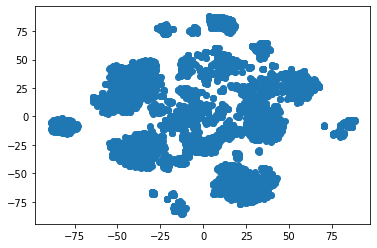

In [6]:
plt.scatter(x=df_embedded[:, 0], y=df_embedded[:, 1])

T-SNE is a great tool for visualizing data in higher dimensions onto a lower-dimensional space because it tries to preserve relative closeness of data points from higher dimensions to lower dimensions. It does so by modeling joint probability distributions of neighboring points and trying to minimize the divergence between the distributions in the higher dimensional and embedded spaces, using a heuristic called Kullback-Leibler divergence. 

However, as the Scikit Learn documentation states themselves, its recommended to use another dimensionality reduction technique like PCA if the number of features is high, and 6000 features is very high. Sometimes, TSNE can produce misleading cluster patterns so its not always recommended to run clustering algorithms such as KMeans on a TSNE embedded dataset. Also, techniques like PCA lend themselves better to being more interpretable, since they produce a linear combination of features in the original dataset

The takeaway from performing TSNE, however, is providing confidence that our data is clustered to some degree. 

Let's now use PCA to visualize the data

In [7]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline

pipe = Pipeline([('scaler', StandardScaler()),
        		 ('reducer', PCA(n_components=2))])

df_pca = pipe.fit_transform(df)
df_pca.shape

(6295, 2)

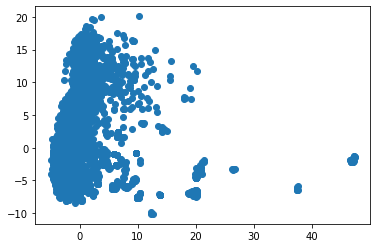

In [8]:
plt.scatter(x=df_pca[:, 0], y=df_pca[:, 1])

This is not at all surprising. We have crammed the information of over 6000 features into 2 PCA components, so we could not realistically have expected the PCA embedding to produce as obvious clusters as TSNE did, and remember, TSNE is designed to keep points that were close in a high dimensional space also close in the embedded space. PCA on the other hand tries to find orthogonal axes that best explain the variance in the data by finding eigenvectors of the covariance matrix. 

Fear not, however, we can still try running clustering algorithms on this PCA embedded space and see what results we get. 

1)K-Means clustering

A common practice when doing K-Means clustering is to use the "Elbow Method" to select the optimal number of clusters by plotting the Within-Sum-Of-Squared-Distances of the clusters against the number of clusters, and finding the point at which WSSD drops the lowest.
However, for all the clustering models that we are going to run, we will be doing an artificial form of GridSearch (since this is an unsupervised learning task and we do not have ground truth labels to perform traditional cross-validation) to try different hyperparameter combinations and evaluating the goodness of the clustering based on metrics like inertia, silhouette score, etc

In [9]:
from sklearn.cluster import KMeans

#Build a hyperparameter grid
K_means_grid = {
    'n_clusters': list(range(3, 11)),
    'max_iter' : [300, 400, 500]
}

#We will be evaluating the "goodness" of the clusters using the _inertia attribute of each KMeans model
K_means_models = []
from itertools import product
for hyperparams in product(*K_means_grid.values()):
    model = KMeans(n_clusters=hyperparams[0], max_iter=hyperparams[1]).fit(df_pca)
    triple = (model, model.labels_, model.inertia_)
    K_means_models.append(triple)

In [10]:
best_K_means_models = sorted(K_means_models, key=lambda x: x[2]) #sort in ascending order of inertia

Let's see the results of the Top 3 K-Means models

<AxesSubplot:>

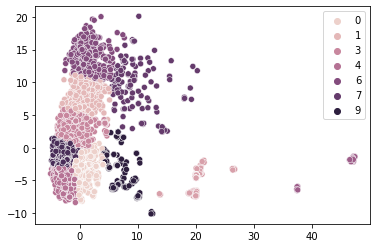

In [11]:
sns.scatterplot(x=df_pca[:, 0], y=df_pca[:, 1], hue=best_K_means_models[0][1])

<AxesSubplot:>

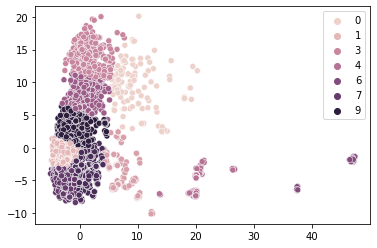

In [12]:
sns.scatterplot(x=df_pca[:, 0], y=df_pca[:, 1], hue=best_K_means_models[1][1])

<AxesSubplot:>

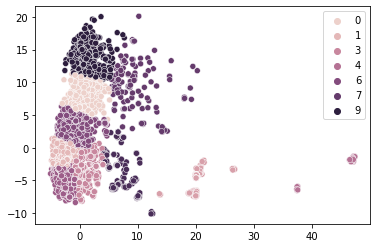

In [13]:
sns.scatterplot(x=df_pca[:, 0], y=df_pca[:, 1], hue=best_K_means_models[2][1])

These clusters don't look half bad. We can see that KMeans managed to divide up the big chunk of data on the left hand side into clusters and also cluster the outliers nicely as well

2)Agglomerative clustering

In [14]:
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score
from sklearn.metrics import calinski_harabasz_score

#Build a hyperparameter grid
Agglomerative_grid = {
    'n_clusters': list(range(3, 11)),
    'linkage': ['ward', 'complete', 'single', 'average']
}

#We will be evaluating the "goodness" of the clusters using the calinski_harabasz_score function
Agglomerative_models = []
from itertools import product
for hyperparams in product(*Agglomerative_grid.values()):
    model = AgglomerativeClustering(n_clusters=hyperparams[0], linkage=hyperparams[1]).fit(df_pca)
    triple = (model, model.labels_, calinski_harabasz_score(df_pca, model.labels_))
    Agglomerative_models.append(triple)


In [15]:
best_agglomerative_models = sorted(Agglomerative_models, key=lambda x: x[2], reverse=True) #sort in descending order of CH score

In [16]:
#Show results of some random Agglomerative Models

<AxesSubplot:>

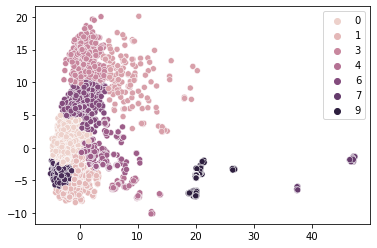

In [17]:
sns.scatterplot(x=df_pca[:, 0], y=df_pca[:, 1], hue=best_agglomerative_models[0][1])

<AxesSubplot:>

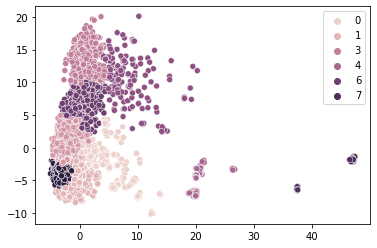

In [18]:
sns.scatterplot(x=df_pca[:, 0], y=df_pca[:, 1], hue=best_agglomerative_models[1][1])

<AxesSubplot:>

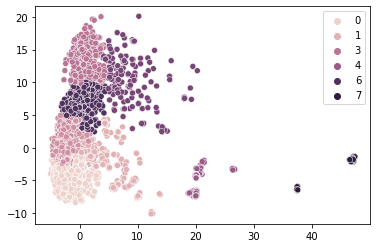

In [19]:
sns.scatterplot(x=df_pca[:, 0], y=df_pca[:, 1], hue=best_agglomerative_models[2][1])

In [20]:
Agglomerative clustering also seems to produce some good clusterings, somewhat similar to KMeans in the regions its identifying

3)GMM clustering

In [43]:
from sklearn.mixture import GaussianMixture

#Build a hyperparameter grid
GMM_grid = {
    'n_components': [3,4,5,6,7,8,9],
    'covariance_type' : ['full', 'tied', 'diag', 'spherical']
}

GMM_models = []
from itertools import product
for hyperparams in product(*GMM_grid.values()):
    model = GaussianMixture(n_components=hyperparams[0], covariance_type=hyperparams[1]).fit(df_pca)
    triple = (model, model.predict(df_pca), calinski_harabasz_score(df_pca, model.predict(df_pca)))
    GMM_models.append(triple)

GMM clustering can be thought of in some ways as being a generalization of KMeans because it has to ability to produce clusters that are non-spherically shaped as well. For example, it can produce oblong or ellipsoidal clusters. To demonstrate this, lets be greedy and plot all the GMM models that were produced.

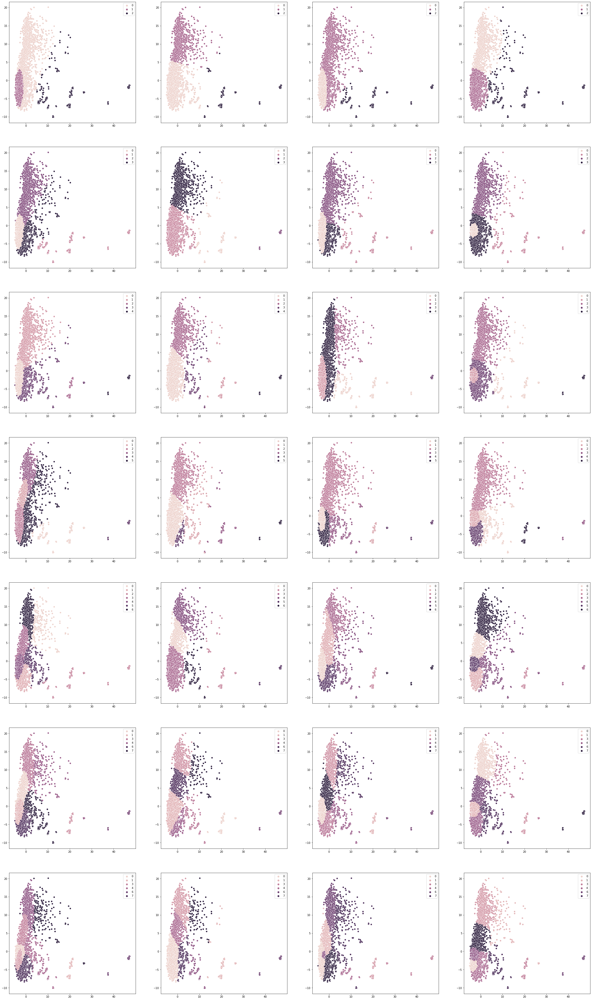

In [44]:
fig, axs = plt.subplots(7, 4)
plt.rcParams["figure.figsize"] = (40,70)
model_num = 0
for i in range(7):
    for j in range(4):
        sns.scatterplot(x=df_pca[:,0], y=df_pca[:,1],hue=GMM_models[model_num][1], ax=axs[i,j])
        model_num += 1


They all look quite aesthetically pleasing but clearly, we can see that its able to produce more interesting cluster shapes than KMeans could. Some of the clusters are more stretched along one axis. These could turn out to be more insightful clusterings when examining the original dataset. Lets find the top 3 clusters again

In [53]:
plt.rcParams["figure.figsize"] = plt.rcParamsDefault["figure.figsize"]

In [49]:
best_GMM_models = sorted(GMM_models, key=lambda x: x[2], reverse=True) #sort in descending order of CH score

<AxesSubplot:>

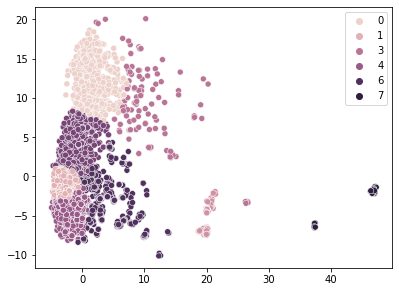

In [54]:
sns.scatterplot(x=df_pca[:, 0], y=df_pca[:, 1], hue=best_GMM_models[0][1])

<AxesSubplot:>

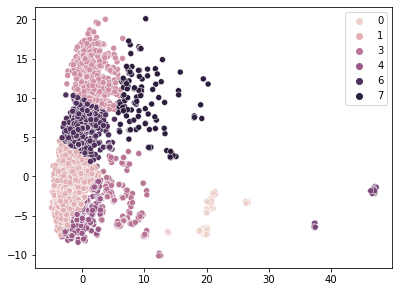

In [55]:
sns.scatterplot(x=df_pca[:, 0], y=df_pca[:, 1], hue=best_GMM_models[1][1])

<AxesSubplot:>

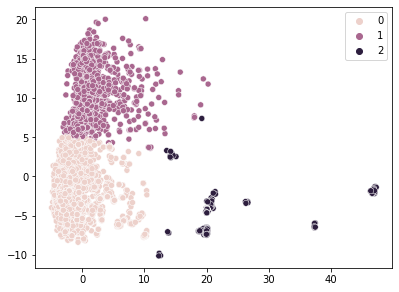

In [56]:
sns.scatterplot(x=df_pca[:, 0], y=df_pca[:, 1], hue=best_GMM_models[2][1])

Interestingly, the 3rd best model produced only 3 clusters, whereas most of the other models produced around 6-7 clusters. This is definitely easier to explain in terms of the original dataset, since the clusters are basically in their own horizontal half partitions of the PCA embedded space, apart from the outlier cluster

So we have our 9 best models from the 3 different clustering strategies ... but we need to select a winner. Lets build a matrix of clustering metric scores against clustering models and see if we can find a global winner or obvious choice

In [57]:
from sklearn.metrics import davies_bouldin_score

top_9_models = [best_K_means_models[0], best_K_means_models[1], best_K_means_models[2], best_agglomerative_models[0], best_agglomerative_models[1], best_agglomerative_models[2], best_GMM_models[0], best_GMM_models[1], best_GMM_models[2]]

silhouette_scores = [silhouette_score(df_pca, model[1]) for model in top_9_models]
CH_scores = [calinski_harabasz_score(df_pca, model[1]) for model in top_9_models]
DB_scores = [davies_bouldin_score(df_pca, model[1]) for model in top_9_models]

index = ['KMeans1', 'KMeans2', 'KMeans3', 'Agg1', 'Agg2', 'Agg3', 'GMM1', 'GMM2', 'GMM3']
model_evaluation_dict = {'Silhouette' : silhouette_scores, 'Calinski-Harabasz' : CH_scores, 'Davies-Bouldin' : DB_scores}
model_evaluation_df = pd.DataFrame(model_evaluation_dict, index=index)
model_evaluation_df

,Silhouette,Calinski-Harabasz,Davies-Bouldin
KMeans1,0.461042,11823.407973,0.672822
KMeans2,0.460581,11822.996806,0.673224
KMeans3,0.460568,11823.002254,0.673168
Agg1,0.392724,10043.642756,0.722770
Agg2,0.383930,9710.192821,0.739843
Agg3,0.414749,9701.141143,0.702419
GMM1,0.446957,9657.825102,0.683192
GMM2,0.471020,9605.482859,0.679979
GMM3,0.668562,9504.415135,0.471880


Keep in mind, we used Calinski-Harabasz to select the top 3 for Agglomerative and GMM in the first place, so the top 3 is biased towards better CH scores for those 2 models. However, we needed some metric to guide us to the best 3.

It seems like the first KMeans model is the best model - it has an excellent CH score, and is also on the better end for both its silhouette score and DB score. The last GMM model is tempting as well (the one that produced two big clusters), but we probably want to identify more than 2 disparate categories in the context of the original University dataset. 

So, *drumroll* looks like our winner is ... the classic K-Means model!

Weve produced some good clustering models ... but now what? They're in the context of the PCA embedded space so how do we explain them? We need to analyze the PCA components and figure out what linear combination of the original features the PCA components correspond to, so we can explain the clusters in the context of the original dataset. 

In [30]:
df_pca_components = pd.DataFrame(pipe.named_steps['reducer'].components_, columns=df.columns, index=['PCA_1', 'PCA_2'])
df_pca_components.head()

,UNITID,OPEID,opeid6,HCM2,main,NUMBRANCH,CONTROL,st_fips,region,LOCALE,...,LO_INC_RPY_3YR_RT_SUPP,MD_INC_RPY_3YR_RT_SUPP,HI_INC_RPY_3YR_RT_SUPP,DEP_RPY_3YR_RT_SUPP,PELL_RPY_3YR_RT_SUPP,NOPELL_RPY_3YR_RT_SUPP,FEMALE_RPY_3YR_RT_SUPP,MALE_RPY_3YR_RT_SUPP,FIRSTGEN_RPY_3YR_RT_SUPP,NOTFIRSTGEN_RPY_3YR_RT_SUPP
PCA_1,0.038058,-0.008311,-0.048006,-2.827175e-24,-0.068283,0.107827,0.014733,-0.000856,-0.003803,-0.013695,...,-0.017789,-0.026924,-0.027921,-0.022608,-0.017002,-0.036259,-0.020057,-0.009436,-0.018926,-0.017998
PCA_2,-0.021725,-0.076395,-0.074627,3.348848e-23,0.064661,-0.051354,-0.074352,0.006493,-0.028889,0.011763,...,0.151516,0.147009,0.139191,0.149299,0.154161,0.141675,0.152059,0.155769,0.150275,0.152780


Let's look at the highest weighted columns from each of the PCA components - we will need this information to explain the best clustering models

In [32]:
df_pca_components.iloc[0].abs().sort_values(ascending=False)

MD_INC_RPY_3YR_N      0.150174
RPY_3YR_N             0.150143
NOPELL_DEBT_N         0.149856
MD_INC_DEBT_N         0.148511
NOTFIRSTGEN_DEBT_N    0.147022
                        ...   
CIP29CERT2            0.000000
CIP25CERT4            0.000000
PCIP29                0.000000
CIP41CERT4            0.000000
CIP39CERT4            0.000000
Name: PCA_1, Length: 221, dtype: float64

In [33]:
df_pca_components.iloc[1].abs().sort_values(ascending=False)

MALE_RPY_3YR_RT_SUPP           0.155769
PELL_RPY_3YR_RT_SUPP           0.154161
NOTFIRSTGEN_RPY_3YR_RT_SUPP    0.152780
FEMALE_RPY_3YR_RT_SUPP         0.152059
LO_INC_RPY_3YR_RT_SUPP         0.151516
                                 ...   
PBI                            0.000000
ANNHI                          0.000000
TRIBAL                         0.000000
AANAPII                        0.000000
CIP39CERT4                     0.000000
Name: PCA_2, Length: 221, dtype: float64